In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import torch
import torch.nn as nn
from PIL import Image
from torchvision import transforms

import os
import sys

sys.path.append("../scripts")
from data import SmallPatchesDataset
from models import AutoEncoder, DEC
from utils import get_embeddings

# autoreload
%load_ext autoreload
%autoreload 2

In [3]:
def plot_sample(sample, ax = None):
    img = sample
    img = img.permute(1, 2, 0).detach().cpu().numpy()
    if ax is None:
        plt.imshow(img)
        plt.axis(False)
        plt.show()
    else:
        ax.imshow(img)

def get_model_centroids_reconstruction(k = 10, latent_dim = 100, small = False):
    if small:
        model_autoencoder = AutoEncoder(latent_dim, encoder_arch= "resnet50_small_patch", decoder_layers_per_block = [3] * 5)
        model_autoencoder.load_state_dict(torch.load(f"../models/AE_resnet50_small_{latent_dim}/model.pt"))
    else:
        model_autoencoder = AutoEncoder(latent_dim, encoder_arch= "resnet50_small", decoder_layers_per_block = [3] * 5)
        model_autoencoder.load_state_dict(torch.load(f"../models/AE_resnet50_{latent_dim}/model.pt"))
    
    encoder = model_autoencoder.encoder
    model = DEC(k, latent_dim, encoder)
    if small:
        model.load_state_dict(torch.load(f"../models/DEC_resnet50_small_{latent_dim}_k_{k}/model.pt"))
    else:
        model.load_state_dict(torch.load(f"../models/DEC_resnet5_{latent_dim}_k_{k}/model.pt"))
    return model_autoencoder.decoder(model.assignment.cluster_centers)

In [4]:
def visualize_model_centroids(centroids):
    n_centroids = centroids.shape[0]
    ncols = 5
    nrows = n_centroids // 5 + (n_centroids % 5 > 0)
    fig, axs = plt.subplots(nrows = nrows, ncols = ncols, figsize = (ncols * 4, nrows * 4))
    axs = axs.flat
    for i in range(n_centroids):
        plot_sample(centroids[i], axs[i])
    [ax.set_axis_off() for ax in axs]

    plt.suptitle(f"Centroids (reconstruction) with k ={n_centroids}")

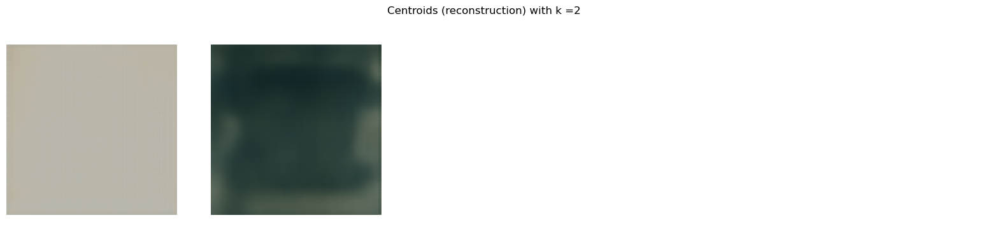

In [5]:
centroids = get_model_centroids_reconstruction(2)
visualize_model_centroids(centroids)

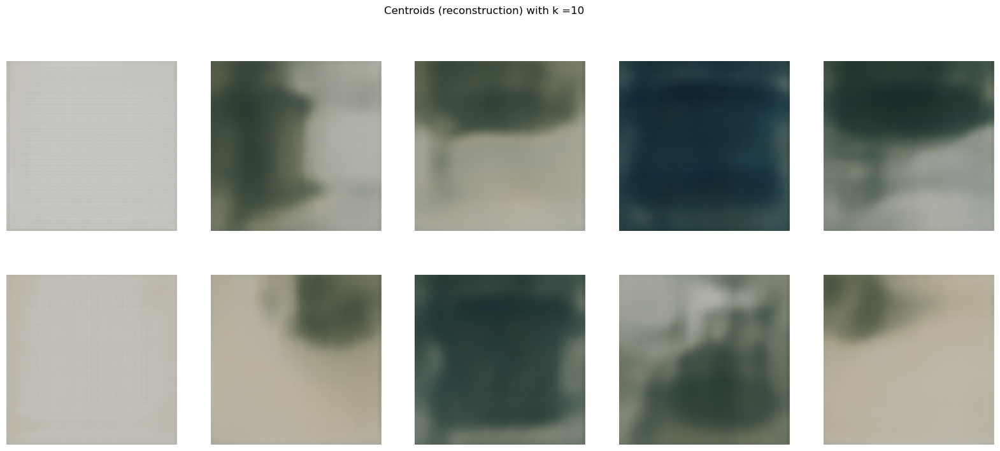

In [23]:
centroids = get_model_centroids_reconstruction(10)
visualize_model_centroids(centroids)

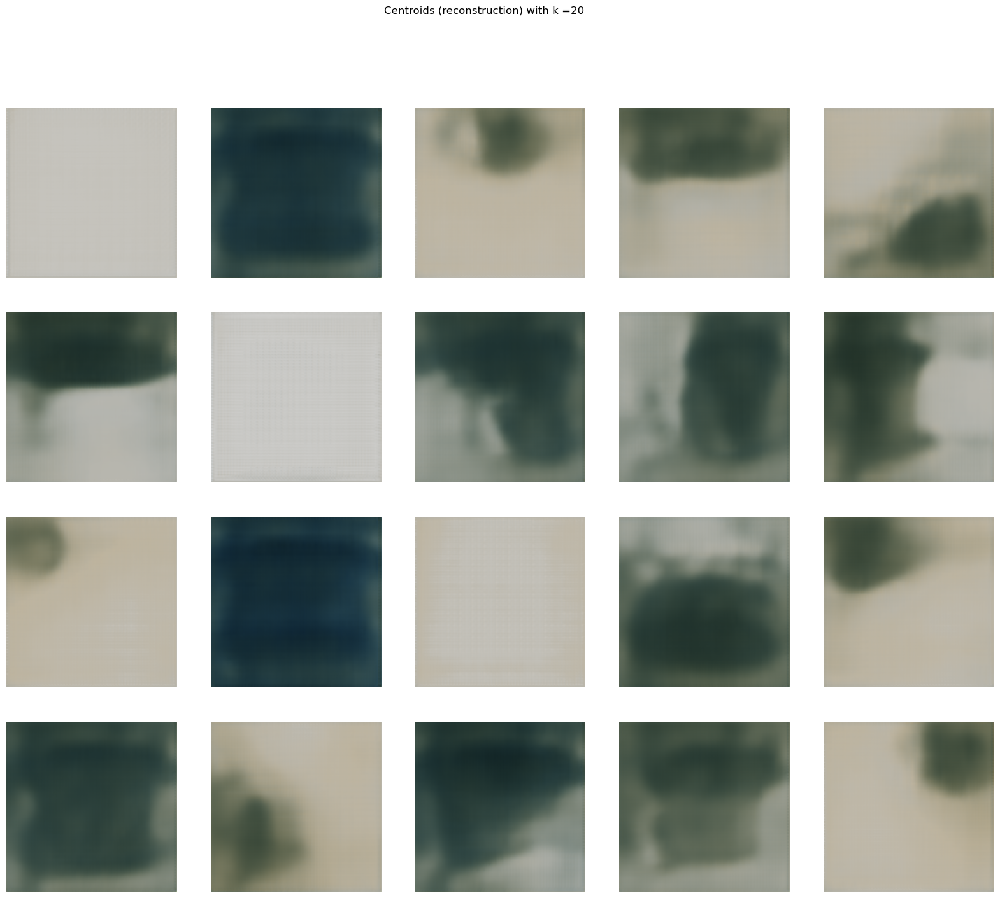

In [24]:
centroids = get_model_centroids_reconstruction(20)
visualize_model_centroids(centroids)

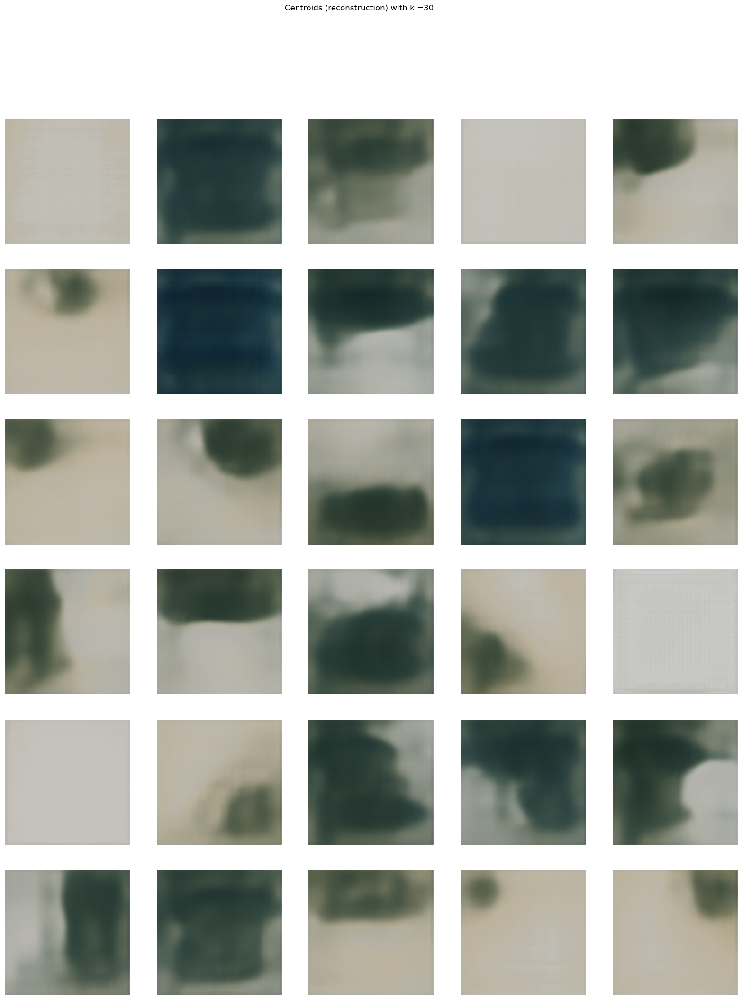

In [25]:
centroids = get_model_centroids_reconstruction(30)
visualize_model_centroids(centroids)

In [6]:
filenames = get_filenames_all_cities(100)
dataset = SmallPatchesDataset(filenames)

In [7]:
def get_model(k, latent_dim = 100):
    model_autoencoder = AutoEncoder(latent_dim, encoder_arch= "resnet50", decoder_layers_per_block = [3] * 5)
    encoder = model_autoencoder.encoder
    model = DEC(k, latent_dim, encoder)
    model.load_state_dict(torch.load(f"../models/DEC_resnet50_clusters_{k}_v2/model.pt"))
    return model

def get_clusters(model):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    model.eval()
    clusters = []
    dl = torch.utils.data.DataLoader(dataset, batch_size=16)
    for batch, _ in dl:
        batch = batch.to(device)
        batch_size = batch.shape[0]
        z = model(batch).detach().cpu().numpy().reshape(batch_size, -1)
        clusters.append(z)
    clusters = np.concatenate(clusters)
    clusters = np.argmax(clusters, axis = 1)
    return clusters

In [10]:
def visualize_cluster_samples(k, clusters, n_samples = 9):
    ncols = 5
    nrows = k // 5 + (k % 5 > 0)
    fig, axs = plt.subplots(nrows = nrows, ncols = ncols, figsize = (ncols * 4, nrows * 4))
    axs = axs.flat
    [ax.set_axis_off() for ax in axs]

    for i in range(k):
        axs[i].set_title(f"Samples of cluster {i}")
        samples = clusters == i
        if samples.sum() == 0:
            continue
        
        random_sample = np.random.choice(np.where(samples)[0], min(n_samples, samples.sum()))
        samples_per_row = int(np.sqrt(n_samples))
        img = torch.zeros((3, 224 * samples_per_row, 224 *samples_per_row))
        for j, idx in enumerate(random_sample):
            img[:, (j // samples_per_row) * 224: (j // samples_per_row + 1) * 224, (j % samples_per_row) * 224: (j % samples_per_row + 1) * 224] = dataset[idx][0]

        plot_sample(img, axs[i])
    plt.suptitle(f"Samples with k = {k}")


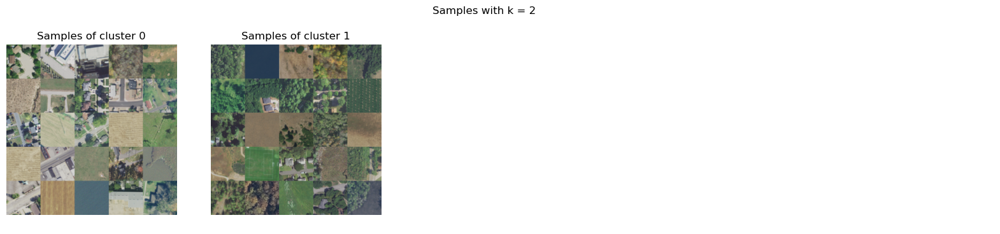

In [12]:
k = 2
model = get_model(2)
clusters = get_clusters(model)
visualize_cluster_samples(2, clusters, 25)

/home/giovani/miniconda3/envs/urban_gdp/lib/python3.9/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


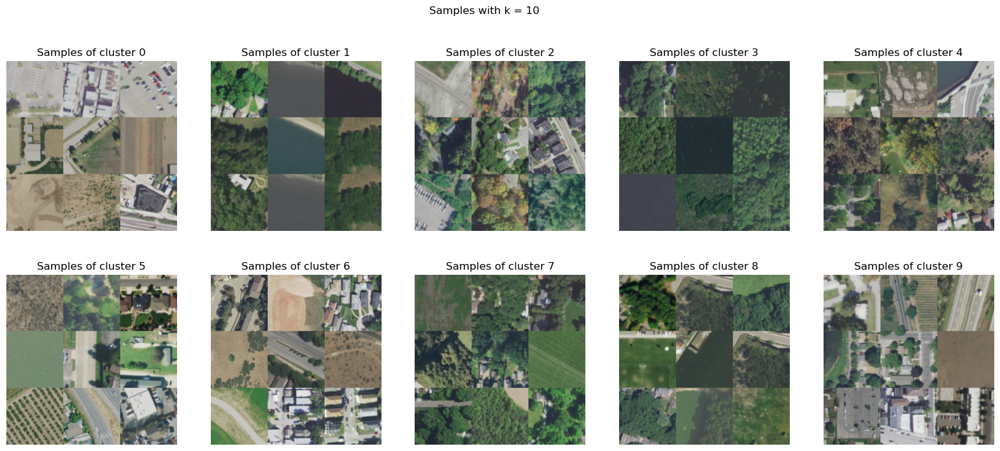

In [14]:
model = get_model(10)
clusters = get_clusters(model)
visualize_cluster_samples(10, clusters)

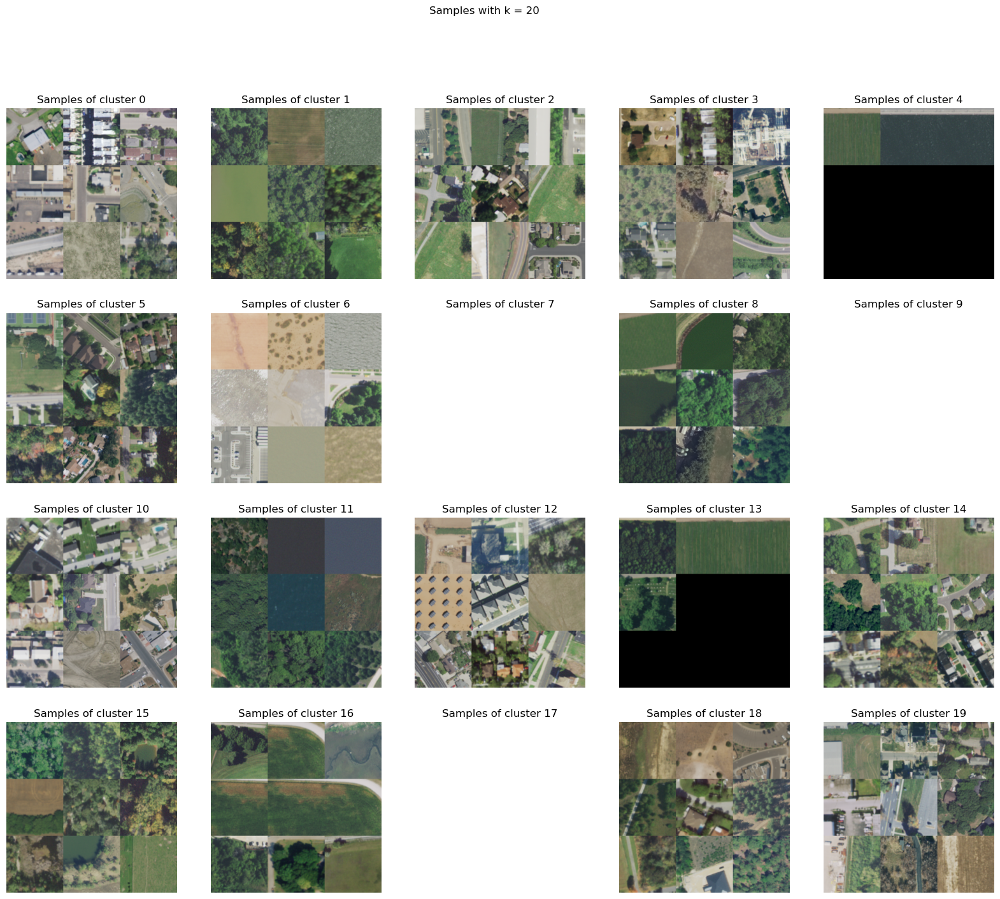

In [45]:
model = get_model(20)
clusters = get_clusters(model)
visualize_cluster_samples(20, clusters)

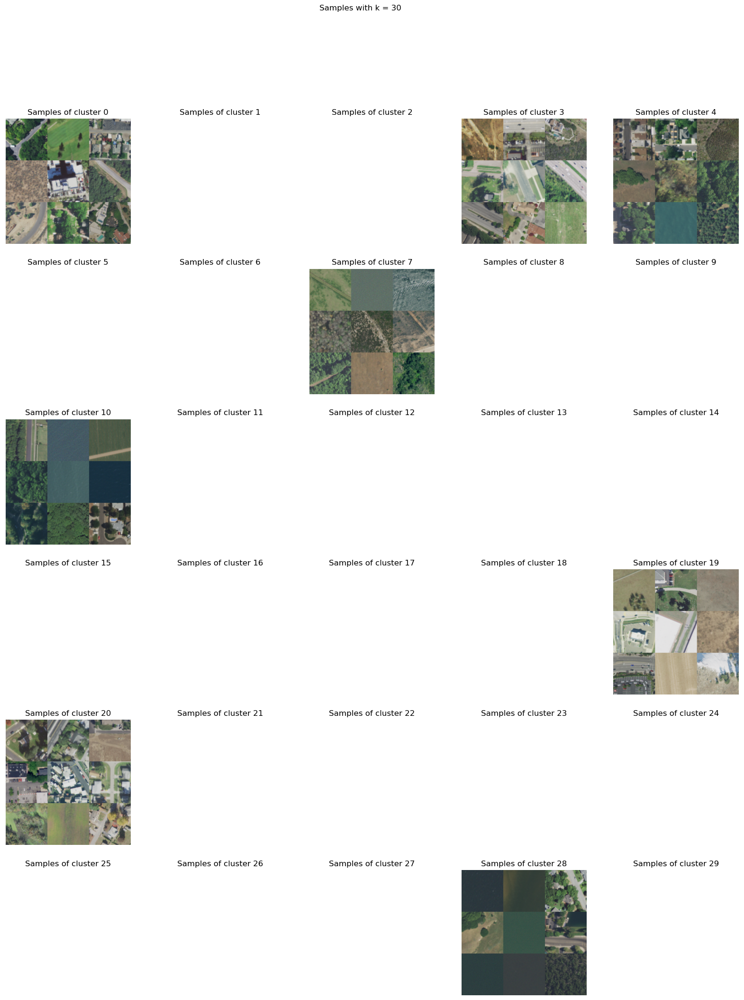

In [16]:
model = get_model(30)
clusters = get_clusters(model)
visualize_cluster_samples(30, clusters)

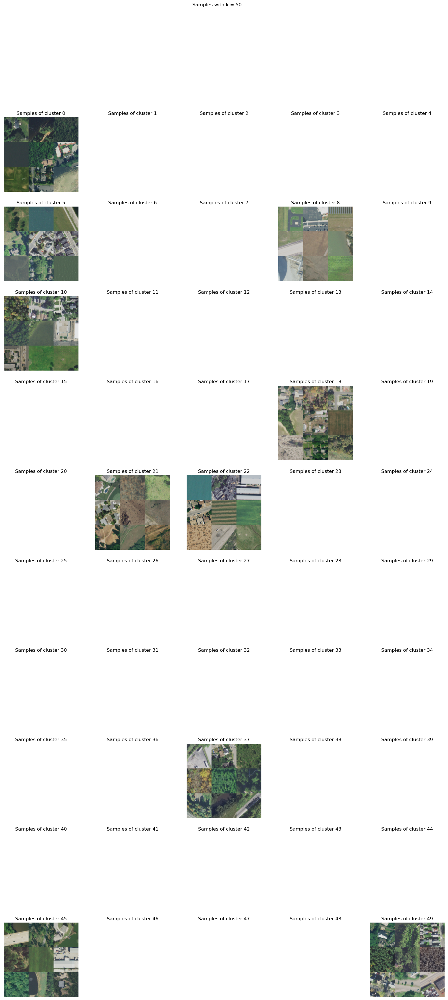

In [17]:
model = get_model(50)
clusters = get_clusters(model)
visualize_cluster_samples(50, clusters)

## Resnet50 with small inputs and denoising

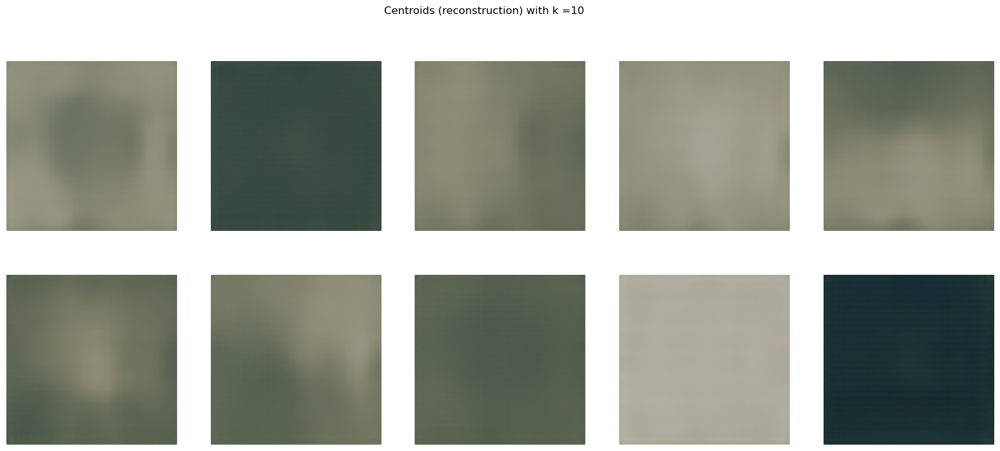

In [5]:
centroids = get_model_centroids_reconstruction(10, 128, True)
visualize_model_centroids(centroids)

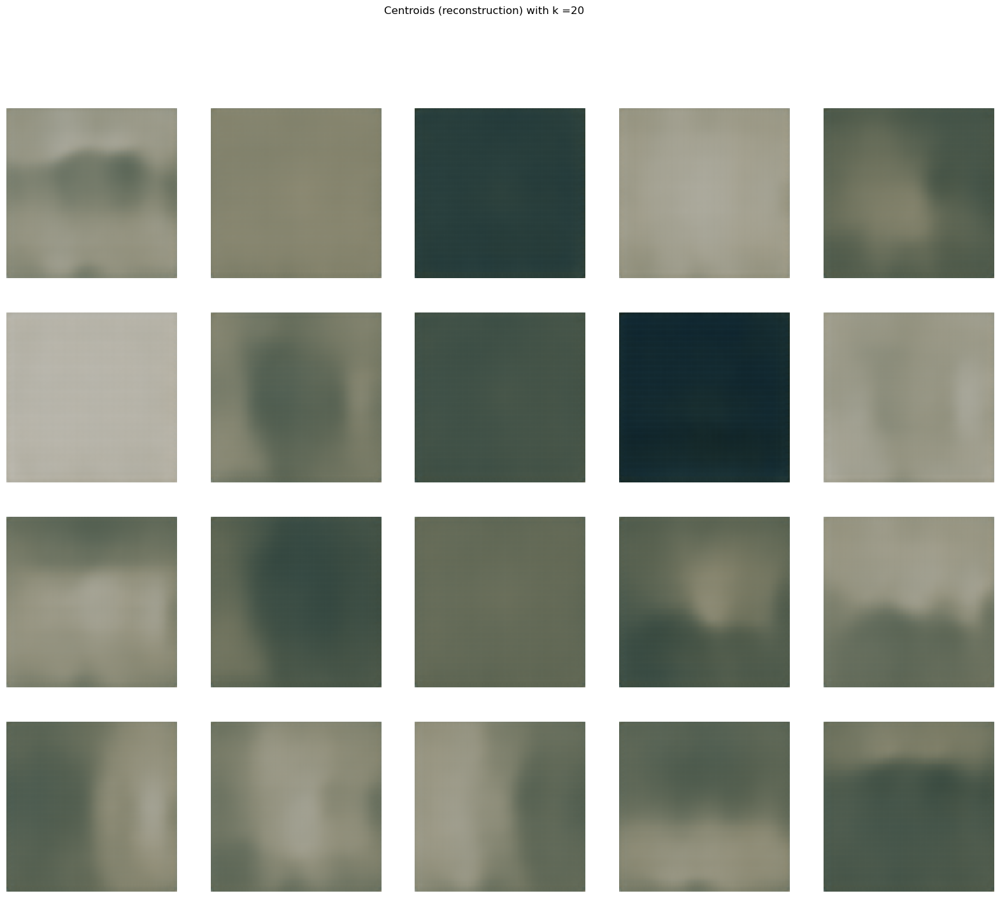

In [10]:
centroids = get_model_centroids_reconstruction(20, 128, True)
visualize_model_centroids(centroids)

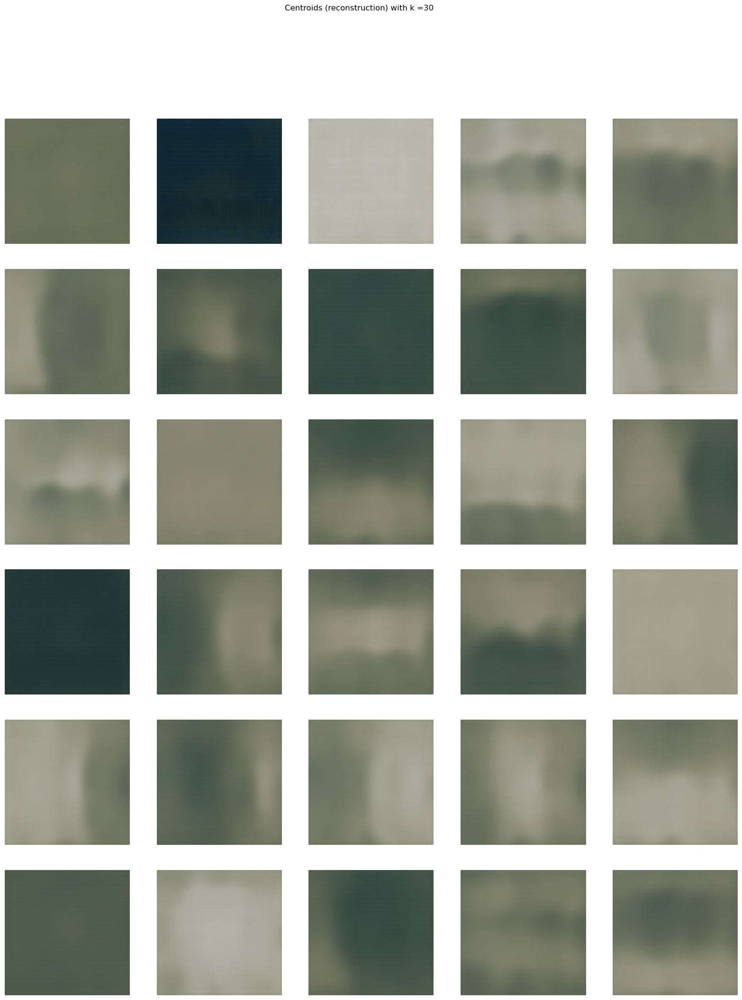

In [11]:
centroids = get_model_centroids_reconstruction(30, 128, True)
visualize_model_centroids(centroids)

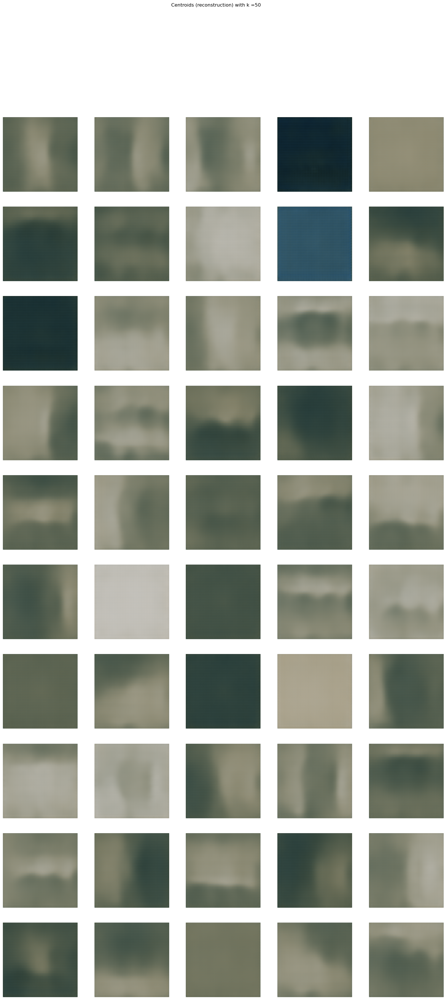

In [12]:
centroids = get_model_centroids_reconstruction(50, 128, True)
visualize_model_centroids(centroids)

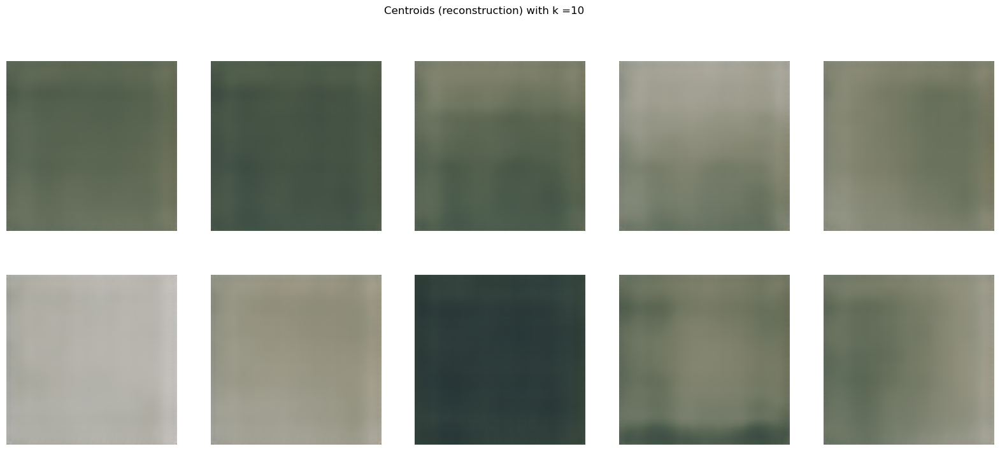

In [6]:
centroids = get_model_centroids_reconstruction(10, 512, True)
visualize_model_centroids(centroids)

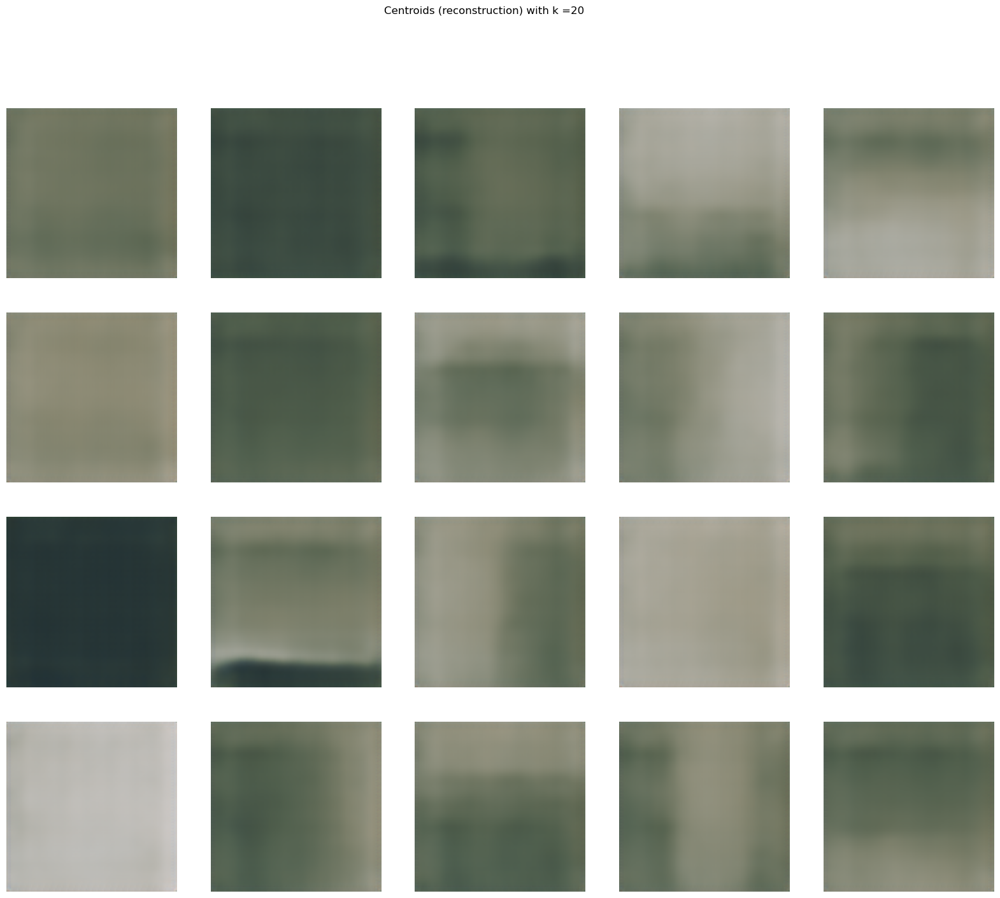

In [7]:
centroids = get_model_centroids_reconstruction(20, 512, True)
visualize_model_centroids(centroids)

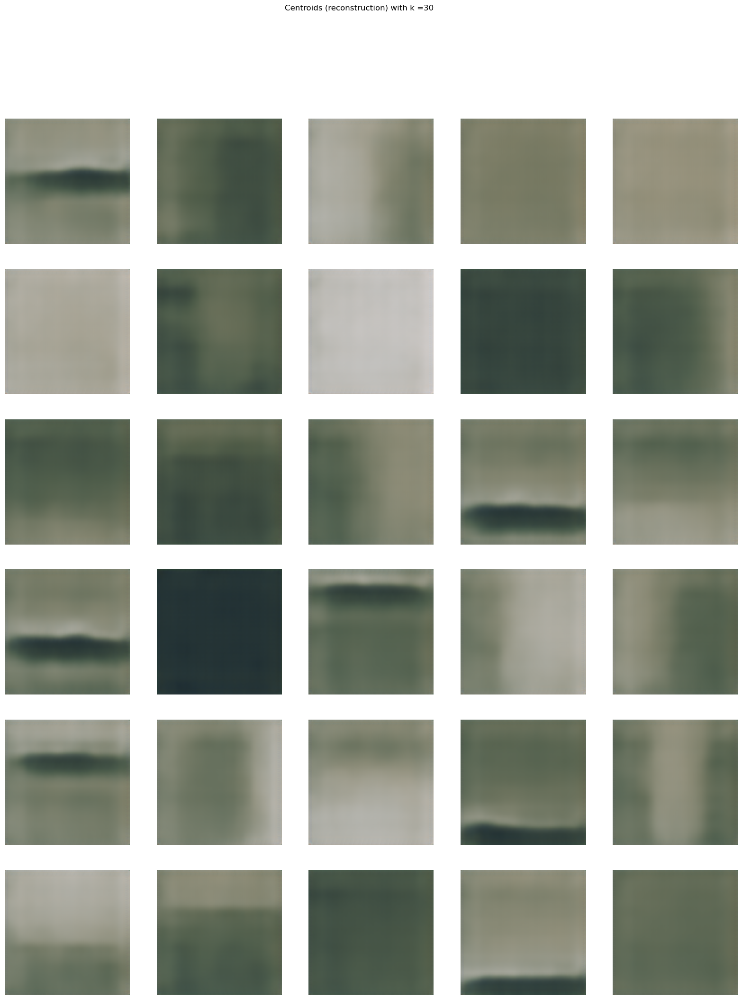

In [8]:
centroids = get_model_centroids_reconstruction(30, 512, True)
visualize_model_centroids(centroids)

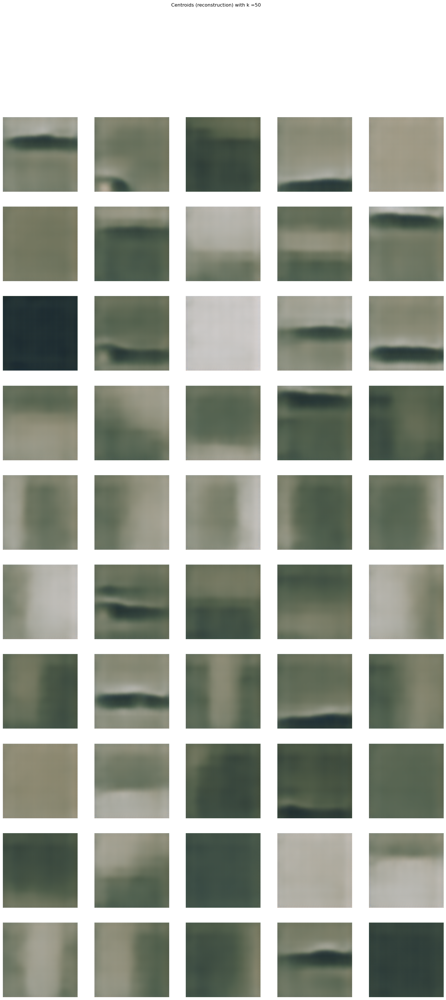

In [9]:
centroids = get_model_centroids_reconstruction(50, 512, True)
visualize_model_centroids(centroids)